In [1]:
import pandas as pd
import numpy as np
import CDIN as cd
import yfinance as yf
import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
datos  = pd.read_csv("BD_Comercio_Exterior_2020.csv")
datos.drop("valor_agregado", axis=1, inplace=True)
datos.drop("Unnamed: 0", axis=1, inplace=True)

C:\Users\jonha\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3326: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [3]:
first = cd.CDIN.dqr(datos)
first

,Nombres,Data_Types,missing_values,present_values,unique_values,min,max
clave_aduana,clave_aduana,int64,0,1021082,59,20,840
fraccion,fraccion,int64,0,1021082,1546,50040001,63109099
subdivision,subdivision,object,510433,510649,26,NaN,NaN
descripcion,descripcion,object,0,1021082,166955,"''T-SHIRTS'', CAMISETAS DE PUNTO DE ALGODON",Ã¿PANTALON LARGO
precio_unitario,precio_unitario,float64,0,1021082,340232,0.0,14720000.0
cantidad_mercancia,cantidad_mercancia,float64,0,1021082,66177,0.001,47707792.0
unidad_medida,unidad_medida,int64,0,1021082,16,1,21
clave_tarifa,clave_tarifa,int64,0,1021082,5,1,9
pais_origen_destino,pais_origen_destino,object,0,1021082,169,ABW,ZYA
tipo_cambio,tipo_cambio,float64,0,1021082,1197,9.3578,25.1185


In [4]:
DB_1 = datos[['precio_unitario', 'cantidad_mercancia', 'clave_aduana', 'fraccion', 'tipo_cambio']]
np.round(DB_1.corr(), 2)

,precio_unitario,cantidad_mercancia,clave_aduana,fraccion,tipo_cambio
precio_unitario,1.00,-0.00,0.01,-0.01,0.01
cantidad_mercancia,-0.00,1.00,-0.00,-0.05,0.01
clave_aduana,0.01,-0.00,1.00,0.01,0.05
fraccion,-0.01,-0.05,0.01,1.00,-0.03
tipo_cambio,0.01,0.01,0.05,-0.03,1.00


C:\Users\jonha\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


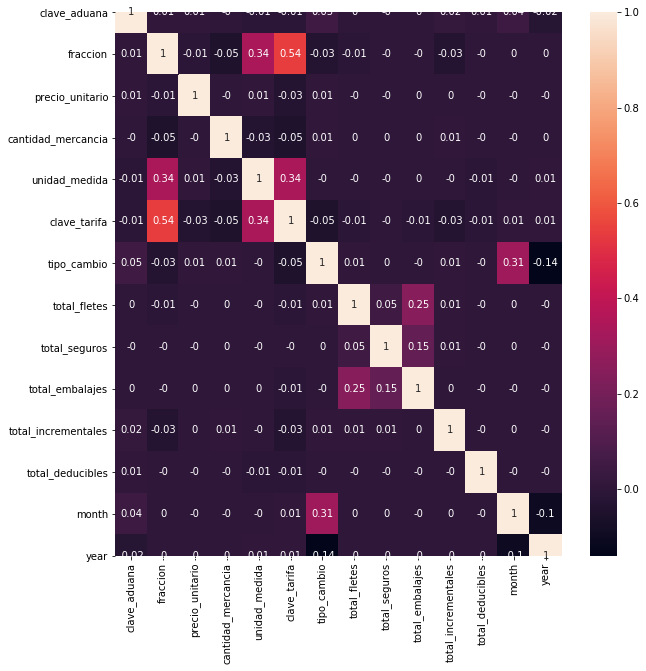

In [5]:
import seaborn as sns
plt.figure(figsize=(10,10))
cov = np.round(datos.select_dtypes(include="number").corr(),2)
labs = datos.select_dtypes(include="number").columns
sns.heatmap(cov, annot = True, fmt="g", xticklabels = labs, yticklabels = labs)
plt.show()

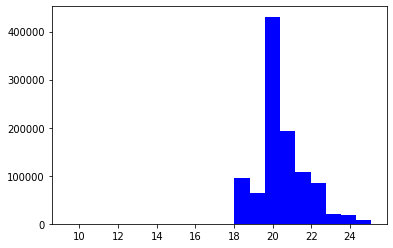

In [6]:
# Histograma tipo de cambio

plt.hist(datos["tipo_cambio"], bins=20, color="b");

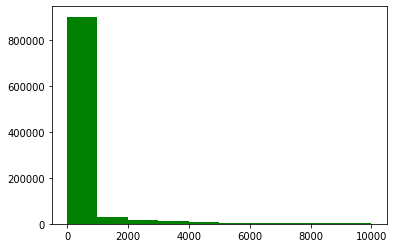

In [7]:
# Histograma cantidad de mercancia

plt.hist(datos["cantidad_mercancia"], bins=10, range=[0,10000], color="g");

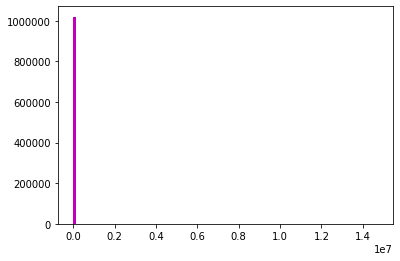

In [8]:
# Histograma precio unitario

plt.hist(datos["precio_unitario"], bins=100, color="m");

In [9]:
datos

,clave_aduana,fraccion,subdivision,descripcion,precio_unitario,cantidad_mercancia,unidad_medida,clave_tarifa,pais_origen_destino,tipo_cambio,total_fletes,total_seguros,total_embalajes,total_incrementales,total_deducibles,month,year
0,200,60063202,NaN,TEJIDOS DE FIBRAS SINTETICAS 100% POLIESTER (T...,37.26148,9787.4,1,1,CHN,19.6113,0.0,0.0,0.0,0.0,0.0,1,2020
1,200,60063102,NaN,TEJIDOS DE FIBRAS SINTETICAS 100% POLIESTER(BL...,31.96652,5824.5,1,1,CHN,19.6113,0.0,0.0,0.0,0.0,0.0,1,2020
2,70,61178099,NaN,MANOPLAS DE KEVLAR/PIEL ID#:MX4KEV,92.47917,96.0,6,6,USA,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020
3,70,61143099,NaN,BATAS DE 100% POLIESTER ID#:3470-L,554.40000,5.0,6,6,SLV,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020
4,70,61143099,NaN,BATAS DE 100% POLIESTER ID#:3470-XL,554.33333,3.0,6,6,SLV,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1021077,160,56075001,0.0,CUERDA 100% POLYESTER RIGIDA Y RECUBIERTA,169.14703,2079.8,1,1,CHN,20.7628,0.0,33.0,0.0,0.0,0.0,11,2021
1021078,160,54023301,0.0,HILADOS 100% DE POLIESTER,51.98874,19800.0,1,1,CHN,20.9632,0.0,0.0,0.0,0.0,0.0,11,2021
1021079,160,55092101,0.0,HILO DE FIBRA CORTA 100% POLIESTER,40.07591,19958.4,1,1,IDN,21.5462,255861.0,2551.0,0.0,4956.0,0.0,11,2021
1021080,160,60041099,2.0,"TEJIDO DE PUNTO 92% POLIESTER, 8% ELASTANO",70.29055,23497.0,1,1,CHN,21.5462,241102.0,5043.0,0.0,0.0,0.0,11,2021


In [10]:
g=np.unique(datos['descripcion'])
g

array(["''T-SHIRTS'', CAMISETAS DE PUNTO DE ALGODON",
       '( D13820960 ) HILADOS DE FIBRAS ARAMIDICAS Partidas: 2',
       '(04743) LIGAS PARA CABELLO CAFE/BEIGE, CTN C/72 PAQS C/U', ...,
       'vestido', 'vestido deportivo', 'Ã¿PANTALON LARGO'], dtype=object)

In [11]:
np.unique(datos['pais_origen_destino'])

array(['ABW', 'AFG', 'AGO', 'ALA', 'ALB', 'AND', 'ARE', 'ARG', 'ARM',
       'ASM', 'ATA', 'ATG', 'AUS', 'AUT', 'BDI', 'BEL', 'BGD', 'BGR',
       'BHR', 'BIH', 'BLR', 'BLZ', 'BMU', 'BOL', 'BRA', 'BRB', 'BRN',
       'BWA', 'CAF', 'CAN', 'CHE', 'CHL', 'CHN', 'CMR', 'COD', 'COL',
       'CPV', 'CRI', 'CYM', 'CZE', 'DEU', 'DJI', 'DMA', 'DNK', 'DOM',
       'DSM', 'DZA', 'ECU', 'EGY', 'EMU', 'ERI', 'ESP', 'EST', 'ETH',
       'FIN', 'FRA', 'FRO', 'FXA', 'GBR', 'GEO', 'GHA', 'GIN', 'GLP',
       'GMB', 'GNB', 'GRC', 'GRL', 'GTM', 'GUY', 'HKG', 'HND', 'HRV',
       'HTI', 'HUN', 'IDN', 'IND', 'IRL', 'IRQ', 'ISL', 'ISR', 'ITA',
       'JAM', 'JOR', 'JPN', 'KCD', 'KEN', 'KHM', 'KOR', 'LAO', 'LBN',
       'LBR', 'LHM', 'LIE', 'LKA', 'LSO', 'LTU', 'LUX', 'LVA', 'MAC',
       'MAR', 'MDA', 'MDG', 'MEX', 'MKD', 'MLI', 'MMR', 'MNE', 'MNG',
       'MNP', 'MOZ', 'MRT', 'MTQ', 'MUS', 'MYS', 'NER', 'NGA', 'NIC',
       'NOR', 'NPL', 'NZL', 'OMN', 'PAK', 'PAN', 'PER', 'PHL', 'POL',
       'PRI', 'PRT',

# Precio promedio por país y diagrama de caja y bigotes

# China

In [12]:
data_china=datos[datos['pais_origen_destino']=='CHN']
data_china.head()

,clave_aduana,fraccion,subdivision,descripcion,precio_unitario,cantidad_mercancia,unidad_medida,clave_tarifa,pais_origen_destino,tipo_cambio,total_fletes,total_seguros,total_embalajes,total_incrementales,total_deducibles,month,year
0,200,60063202,NaN,TEJIDOS DE FIBRAS SINTETICAS 100% POLIESTER (T...,37.26148,9787.4,1,1,CHN,19.6113,0.0,0.0,0.0,0.0,0.0,1,2020
1,200,60063102,NaN,TEJIDOS DE FIBRAS SINTETICAS 100% POLIESTER(BL...,31.96652,5824.5,1,1,CHN,19.6113,0.0,0.0,0.0,0.0,0.0,1,2020
9,70,62101001,NaN,OVEROLES 100% POLIPROPILENO MODELO:APCVCH...,16.79600,500.0,6,6,CHN,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020
11,70,61161099,NaN,GUANTES DE 95 % KEVLAR 5 % LICRA IMPREGNADO...,26.81481,432.0,9,9,CHN,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020
17,70,61161099,NaN,GUANTES 90% KEVLAR 6% STEEL 4% LICRA CON RECUB...,43.97222,36.0,9,9,CHN,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020


In [13]:
fig = px.box(data_china['precio_unitario'])
fig.show()

In [14]:
data_china['precio_unitario'].mean()

371.6824167293942

# USA

In [15]:
data_usa=datos[datos['pais_origen_destino']=='USA']
data_usa.head()

,clave_aduana,fraccion,subdivision,descripcion,precio_unitario,cantidad_mercancia,unidad_medida,clave_tarifa,pais_origen_destino,tipo_cambio,total_fletes,total_seguros,total_embalajes,total_incrementales,total_deducibles,month,year
2,70,61178099,NaN,MANOPLAS DE KEVLAR/PIEL ID#:MX4KEV,92.47917,96.0,6,6,USA,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020
5,70,61178099,NaN,MANGAS 100% ALGODON ID#:AXFR183ST,28.12083,240.0,6,6,USA,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020
6,70,61178099,NaN,MANGAS 100:ALGODON ID#:MXKEV18TSVEL,46.61458,96.0,6,6,USA,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020
8,70,61178099,NaN,"MANGAS 100% ALGODON MODELO:MXKEV18, ID...",31.89583,240.0,6,6,USA,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020
10,70,61178099,NaN,MANGAS 100% ALGODON ID#:MXKEV18TSVEL,46.61806,144.0,6,6,USA,18.8727,0.0,0.0,0.0,11324.0,0.0,1,2020


In [16]:
fig = px.box(data_usa['precio_unitario'])
fig.show()

In [17]:
data_usa['precio_unitario'].mean()

1685.1027129893498

# Mexico

In [18]:
data_mx=datos[datos['pais_origen_destino']=='MEX']
data_mx.head()

,clave_aduana,fraccion,subdivision,descripcion,precio_unitario,cantidad_mercancia,unidad_medida,clave_tarifa,pais_origen_destino,tipo_cambio,total_fletes,total_seguros,total_embalajes,total_incrementales,total_deducibles,month,year
39,521,56022901,NaN,PROTECTORES DE OLLAS CON SU FUNDA,81.33333,3.0,12,1,MEX,18.8452,0.0,0.0,0.0,0.0,0.0,1,2020
61,533,61099003,NaN,T SHIRT DE PUNTO,178.46875,96.0,6,6,MEX,19.4468,145945.0,0.0,0.0,25436.0,0.0,1,2020
148,521,56022901,NaN,PROTECTORES DE OLLAS CON SU FUNDA,86.00000,1.0,12,1,MEX,18.8817,0.0,0.0,0.0,0.0,0.0,1,2020
213,650,61046302,NaN,PANTALONES CORTOS PARA MUJER DE FIBRAS SINTETI...,472.33333,6.0,6,6,MEX,18.8642,0.0,85.0,0.0,0.0,0.0,1,2020
221,731,61102002,NaN,PAYERA TERMICA,150.00000,1.0,6,6,MEX,18.8642,0.0,0.0,0.0,0.0,0.0,1,2020


In [19]:
px.box(data_mx['precio_unitario']).show()

In [20]:
data_mx['precio_unitario'].mean()

368.8804088932481

# Brasil

In [21]:
data_brasil=datos[datos['pais_origen_destino']=='BRA']
data_brasil.head()

,clave_aduana,fraccion,subdivision,descripcion,precio_unitario,cantidad_mercancia,unidad_medida,clave_tarifa,pais_origen_destino,tipo_cambio,total_fletes,total_seguros,total_embalajes,total_incrementales,total_deducibles,month,year
252,530,63026002,NaN,TOALLA DE BUCLE DE 100% ALGODON (MEDIDAS 30 CM...,31.00000,1.0,6,6,BRA,18.9445,6860.0,0.0,0.0,9510.0,0.0,1,2020
253,530,63026002,NaN,TOALLA DE BUCLE DE 100% ALGODÃ N (MEDIDA 30 CM...,31.26000,200.0,6,6,BRA,18.9445,6860.0,0.0,0.0,9510.0,0.0,1,2020
254,530,63026003,NaN,TOALLA DE BUCLE DE 100% ALGODÃ N (MEDIDA 48 CM...,79.56000,50.0,6,6,BRA,18.9445,6860.0,0.0,0.0,9510.0,0.0,1,2020
255,530,63026003,NaN,TAPETE TOALLA PARA BAÂ¥O DE BUCLE DE 100% ALGO...,153.45333,150.0,6,6,BRA,18.9445,6860.0,0.0,0.0,9510.0,0.0,1,2020
256,530,63026099,NaN,TOALLA DE BUCLE DE 100% ALGODÃ N (MEDIDA 100 C...,322.06000,100.0,6,6,BRA,18.9445,6860.0,0.0,0.0,9510.0,0.0,1,2020


In [22]:
px.box(data_brasil['precio_unitario']).show()

In [23]:
data_brasil['precio_unitario'].mean()

8422.372806989119

# Gran Bretaña

In [24]:
data_GBR=datos[datos['pais_origen_destino']=='GBR']
data_GBR.head()

,clave_aduana,fraccion,subdivision,descripcion,precio_unitario,cantidad_mercancia,unidad_medida,clave_tarifa,pais_origen_destino,tipo_cambio,total_fletes,total_seguros,total_embalajes,total_incrementales,total_deducibles,month,year
2943,240,63029101,NaN,TOALLA VINTAGE,173.33333,3.0,6,6,GBR,18.8642,0.0,0.0,0.0,4056.0,0.0,1,2020
5569,470,62142001,NaN,"BUFANDAS DE LANA NO DE PUNTO Partidas: 545,597...",2405.00000,4.0,6,6,GBR,18.8727,52519.0,5211.0,0.0,0.0,0.0,1,2020
5575,470,63012001,NaN,MANTAS DE LANA Partidas: 7,9879.00000,1.0,6,6,GBR,18.8727,52519.0,5211.0,0.0,0.0,0.0,1,2020
5967,470,62044491,NaN,VESTIDO,21409.37000,1.0,6,6,GBR,18.9445,16816.0,1669.0,0.0,24122.0,0.0,1,2020
5969,470,62044999,NaN,VESTIDO,23957.59000,1.0,6,6,GBR,18.9445,16816.0,1669.0,0.0,24122.0,0.0,1,2020


In [25]:
px.box(data_GBR['precio_unitario']).show()

In [26]:
data_GBR['precio_unitario'].mean()

2532.3168758657534

# Precio promedio de artículos

In [27]:
datos[datos['descripcion']=='T SHIRT DE PUNTO']['precio_unitario'].mean()

102.26608575757581

In [28]:
datos[datos['descripcion']=='VESTIDO']['precio_unitario'].mean()

607.822693186901

# Exportaciones por año

In [29]:
len(datos[datos['year']==2020])

512294

In [30]:
len(datos[datos['year']==2021])

508788

# Mes vs Precio unitario por año

# 2020

In [31]:
data_2020 = datos[datos['year']==2020]
anio_2020=[0,0,0,0,0,0,0,0,0,0,0,0]
for i in range(12):
    anio_2020[i]=data_2020[data_2020['month']==i+1]['precio_unitario'].sum()
meses=[1,2,3,4,5,6,7,8,9,10,11,12]
px.bar(x=meses,y=anio_2020,labels={'y':'Precio unitario','x':'Meses'})

# 2021

In [32]:
data_2021 = datos[datos['year']==2021]
anio_2021=[0,0,0,0,0,0,0,0,0,0,0]
for i in range(11):
    anio_2021[i]=data_2021[data_2021['month']==i+1]['precio_unitario'].sum()

In [33]:
meses=[1,2,3,4,5,6,7,8,9,10,11]
px.bar(x=meses,y=anio_2021,labels={'y':'Precio unitario','x':'Meses'})